In [1]:
import os
import numpy as np
import tifffile as tiff
import matplotlib.pyplot as plt
import cv2
import math


# Define folder path
base_folder = "./IDP Group A"

# Define wavelength list (450 nm to 950 nm in 20 nm steps)
wavelengths = list(range(450, 951, 20))

# Define subfolders
sample_folders = [f"d{i}" for i in range(1, 15)]  # d1 to d14
dark_folder = "dark"
white_folder = "white"
reference_folder = "reference image"


# Load white and dark images
def load_cube(folder_path):
    tif_files = [f for f in os.listdir(folder_path) if f.lower().endswith(".tif")]
    tif_files.sort()

    cube = []
    for tif_file in tif_files:
        tif_path = os.path.join(folder_path, tif_file)
        tif = tiff.imread(tif_path)
        cube.append(tif)

    cube = np.array(cube)

    return cube


# Load dark and white reference cubes
dark_cube = load_cube(os.path.join(base_folder, dark_folder))
white_cube = load_cube(os.path.join(base_folder, white_folder))
reference_cube = load_cube(os.path.join(base_folder, reference_folder))


# Avoid division by zero
denominator = white_cube - dark_cube
denominator[denominator == 0] = 1e-6

# Load and compute reflectance for each sample
defect_cubes = {}

for folder in sample_folders:
    sample_cube = load_cube(os.path.join(base_folder, folder))
    R = (sample_cube - dark_cube) / denominator
    defect_cubes[folder] = R  # Shape: (bands, height, width)

In [2]:
R_sample = (reference_cube - dark_cube) / denominator

print(f"R_sample.shape: {R_sample.shape}")

R_sample.shape: (26, 1040, 1392)


In [3]:
def plot_image(image, title=""):
    # Plot the image
    plt.figure(figsize=(6, 5))
    plt.imshow(image, cmap="gray")
    plt.colorbar(label="Pixel Value")
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()


def plot_example_reflectance(defect_cubes, sample_name, wavelength):
    # Get reflectance cube
    R = defect_cubes[sample_name]

    # Extract 2D image at selected wavelength
    reflectance_image = R[wavelengths.index(wavelength), :, :]
    title = f"Reflectance of {sample_name} at {wavelength} nm"

    plot_image(reflectance_image, title)


def plot_original_tif(tif_path):
    image = tiff.imread(tif_path)

    plot_image(image, tif_path)


def get_example_reflectance(defect_cubes, sample_name, wavelength):
    # Get reflectance cube
    R = defect_cubes[sample_name]

    # Extract 2D image at selected wavelength
    reflectance_image = R[wavelengths.index(wavelength), :, :]

    return reflectance_image

In [4]:
from sklearn.cluster import KMeans
from scipy.ndimage import binary_fill_holes


def convert_binary_image(defect_cubes, defect, band):
    gray = get_example_reflectance(defect_cubes, defect, band)
    gray_norm = gray / np.max(gray)
    gray_norm = (gray_norm * 255).astype(np.uint8)
    _, binary_image = cv2.threshold(gray_norm, 60, 255, cv2.THRESH_BINARY_INV)

    return binary_image


def overlay_mask(base_image, mask, title, color=(1, 0, 0), alpha=0.5):
    base_image = base_image.astype(np.float32)
    if base_image.shape[0] == 3:
        base_image = np.transpose(base_image, (1, 2, 0))
    base_norm = base_image / 255.0 if base_image.max() > 1 else base_image

    overlay = np.zeros_like(base_norm)
    overlay[..., :3] = color

    blended = base_norm.copy()
    mask_bool = mask == 1
    blended[mask_bool] = (1 - alpha) * base_norm[mask_bool] + alpha * overlay[mask_bool]

    plt.figure(figsize=(6, 6))
    plt.imshow(np.clip(blended, 0, 1))
    plt.axis("off")
    plt.title(title)
    plt.show()


def compute_IC_mask(RGB_image):
    RGB_image = RGB_image.astype(np.float32)

    if RGB_image.shape[0] == 3:
        RGB_image = np.transpose(RGB_image, (1, 2, 0))

    height, width, bands = RGB_image.shape
    pixels = RGB_image.reshape(-1, bands)
    pixels /= np.linalg.norm(pixels, axis=1, keepdims=True) + 1e-6

    k_means = KMeans(n_clusters=5, random_state=0, n_init=10)
    labels = k_means.fit_predict(pixels)
    segmented_image = labels.reshape(height, width)

    pixel_IC = (300, 190)
    IC_label = segmented_image[pixel_IC]
    mask = (segmented_image == IC_label).astype(np.uint8)

    flood_mask = mask.copy()
    cv2.floodFill(flood_mask, None, (pixel_IC[1], pixel_IC[0]), 128)
    circle_mask = (flood_mask == 128).astype(np.uint8)

    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
    closed = cv2.morphologyEx(circle_mask, cv2.MORPH_CLOSE, kernel)
    filled = binary_fill_holes(closed > 0)

    return filled.astype(np.uint8)


def align_and_visualise(
    img_ref, img_to_align, defect, n_features=5000, n_good_matches=50
):
    orb = cv2.ORB_create(n_features)
    kp1, des1 = orb.detectAndCompute(img_ref, None)
    kp2, des2 = orb.detectAndCompute(img_to_align, None)

    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = sorted(bf.match(des1, des2), key=lambda x: x.distance)
    good_matches = matches[:n_good_matches]

    pts_ref = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 2)
    pts_to = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 2)

    H, _ = cv2.findHomography(pts_to, pts_ref, cv2.RANSAC, 5.0)
    A, _ = cv2.estimateAffinePartial2D(pts_to, pts_ref, method=cv2.RANSAC)
    A_3x3 = np.vstack([A, [0, 0, 1]]) if A is not None else None

    aligned = cv2.warpPerspective(img_to_align, H, (img_ref.shape[1], img_ref.shape[0]))

    match_vis = cv2.drawMatches(
        cv2.cvtColor(img_ref, cv2.COLOR_GRAY2BGR),
        kp1,
        cv2.cvtColor(img_to_align, cv2.COLOR_GRAY2BGR),
        kp2,
        good_matches,
        None,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
    )

    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(match_vis)
    plt.title(f"Feature mapping {defect}, {len(good_matches)}")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(aligned, cmap="gray")
    plt.title(f"aligned_binary_{defect}")

    plt.subplot(1, 3, 3)
    overlay = cv2.addWeighted(
        cv2.cvtColor(img_ref, cv2.COLOR_GRAY2BGR),
        0.5,
        cv2.cvtColor(aligned, cv2.COLOR_GRAY2BGR),
        0.5,
        0,
    )
    plt.imshow(overlay)
    plt.title(f"Overlap_{defect}")
    plt.axis("off")

    plt.show()

    print("\nAffine (A as 3x3):\n", A_3x3)

    if A is not None:
        M = A[:, :2]
        tx, ty = A[:, 2]
        sx = np.linalg.norm(M[:, 0])
        sy = np.linalg.norm(M[:, 1])
        theta = math.atan2(M[1, 0], M[0, 0])
        print(f"\nAffine decomposition:")
        print(f"  Translation (tx, ty): ({tx:.2f}, {ty:.2f})")
        print(f"  Scale (sx, sy): ({sx:.3f}, {sy:.3f})")
        print(f"  Rotation: {math.degrees(theta):.2f}°")

    return A_3x3


def align_and_blend_RGB(ref_rgb, defect_rgb, A_3x3, defect_name):
    A_2x3 = A_3x3[:2, :]
    h, w = ref_rgb.shape[:2]
    aligned_defect = cv2.warpAffine(defect_rgb, A_2x3, (w, h))
    blended = cv2.addWeighted(ref_rgb, 0.5, aligned_defect, 0.5, 0)

    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(ref_rgb)
    plt.title("Reference RGB")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(aligned_defect)
    plt.title(f"Aligned {defect_name} RGB (Affine transformed)")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(blended)
    plt.title(f"Overlap {defect_name}")
    plt.axis("off")

    return aligned_defect, blended


def extract_RGB(cube, wavelengths):
    return cube[
        [wavelengths.index(650), wavelengths.index(550), wavelengths.index(470)],
        :,
        :,
    ]

In [5]:
defects = [
    "d1",
    "d2",
    "d3",
    "d4",
    "d5",
    "d6",
    "d7",
    "d8",
    "d9",
    "d10",
    "d11",
    "d12",
    "d13",
    "d14",
]
band = 550


ref_RGB = R_sample[
    [wavelengths.index(650), wavelengths.index(550), wavelengths.index(470)],
    :,
    :,
]
ref_rgb = np.moveaxis(ref_RGB, 0, -1)


ref_mask = compute_IC_mask(ref_rgb)


R_image = R_sample[wavelengths.index(band), :, :]
R_image_norm = R_image / np.max(R_image)
R_image_norm = (R_image_norm * 255).astype(np.uint8)
_, R_image_binary = cv2.threshold(R_image_norm, 60, 255, cv2.THRESH_BINARY_INV)

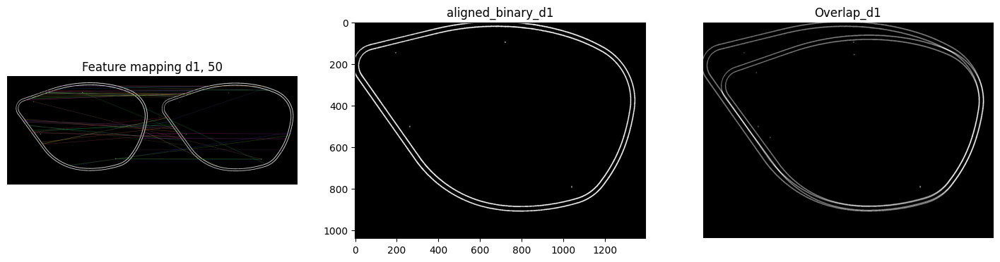


Affine (A as 3x3):
 [[ 9.98127898e-01  5.49397432e-03 -7.62823393e+00]
 [-5.49397432e-03  9.98127898e-01  3.79295797e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-7.63, 3.79)
  Scale (sx, sy): (0.998, 0.998)
  Rotation: -0.32°


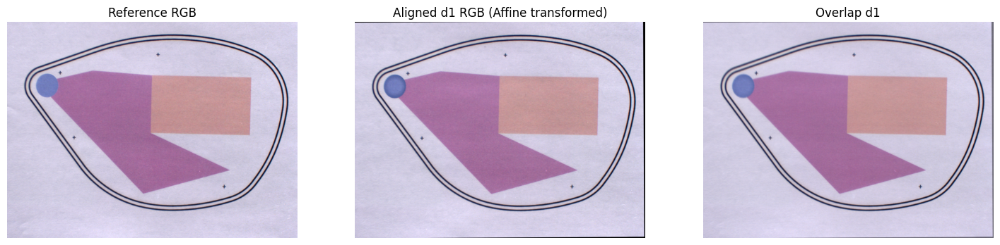

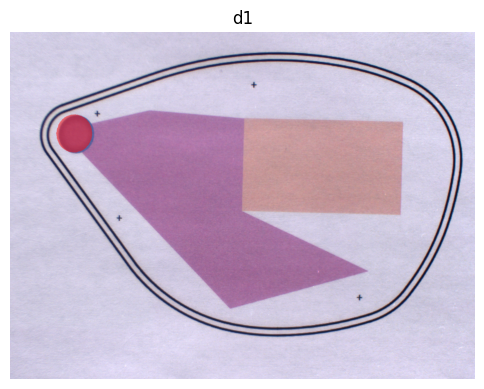

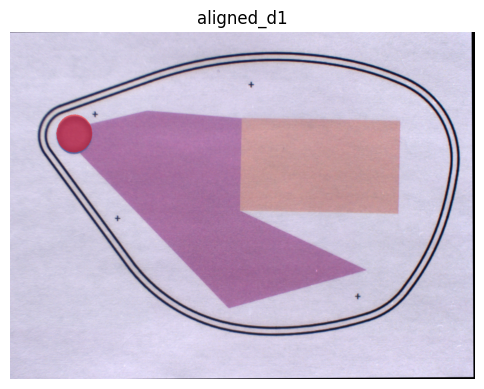

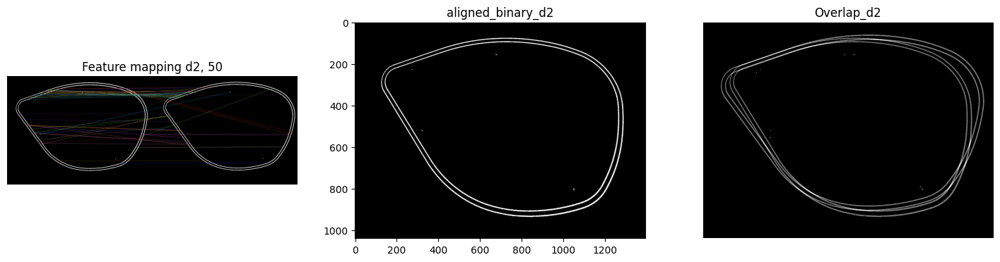


Affine (A as 3x3):
 [[ 9.99740153e-01  6.17398863e-03 -2.35394262e+01]
 [-6.17398863e-03  9.99740153e-01  9.43602856e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-23.54, 9.44)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: -0.35°


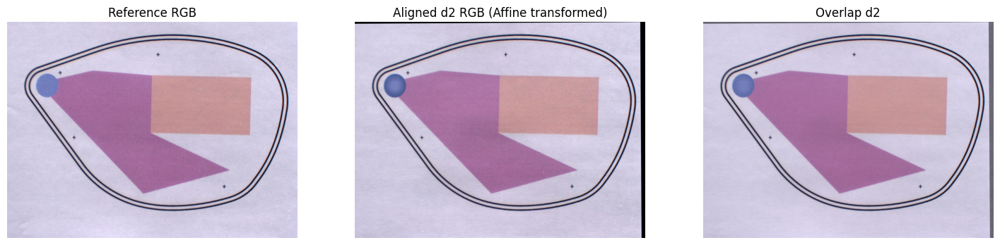

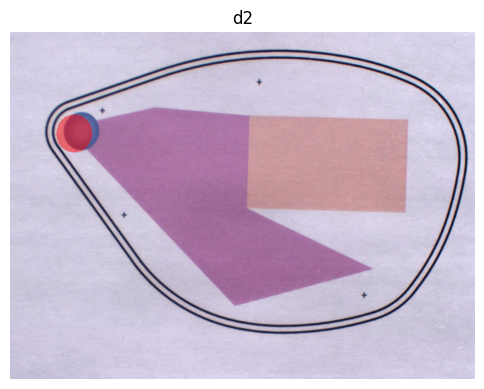

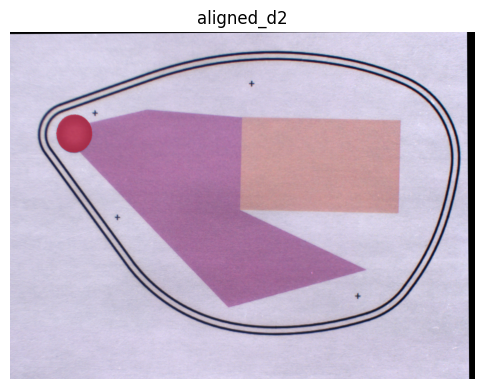

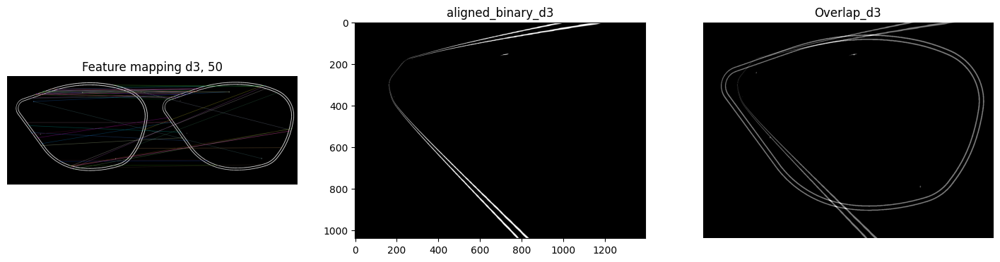


Affine (A as 3x3):
 [[ 1.02904138e+00  1.83454330e-02 -3.81042368e+01]
 [-1.83454330e-02  1.02904138e+00  1.35342157e+01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-38.10, 13.53)
  Scale (sx, sy): (1.029, 1.029)
  Rotation: -1.02°


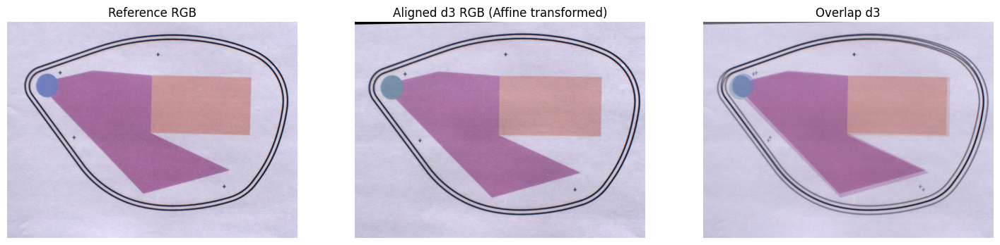

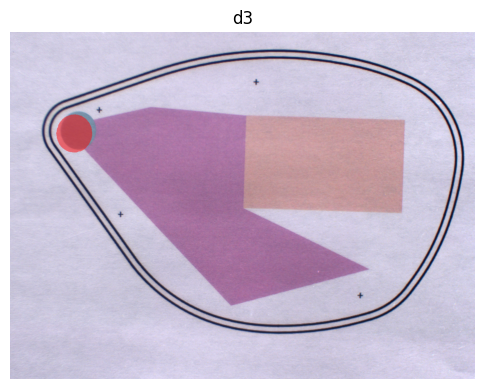

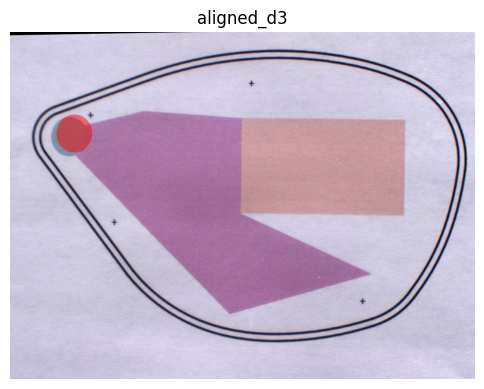

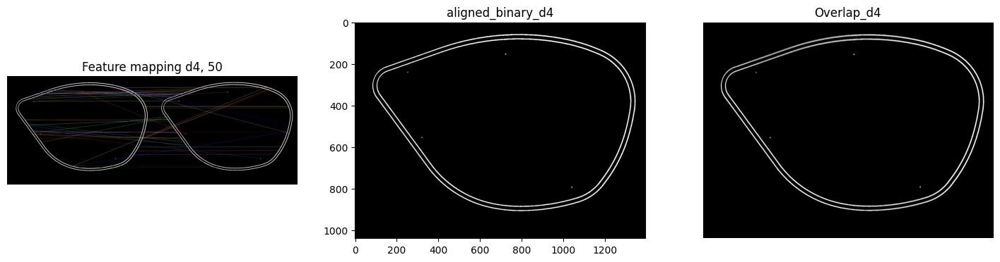


Affine (A as 3x3):
 [[ 1.00120035e+00  2.14718166e-03 -2.54984802e+00]
 [-2.14718166e-03  1.00120035e+00  4.48401754e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-2.55, 4.48)
  Scale (sx, sy): (1.001, 1.001)
  Rotation: -0.12°


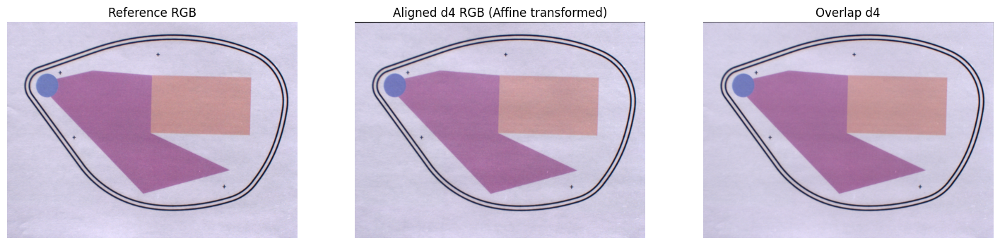

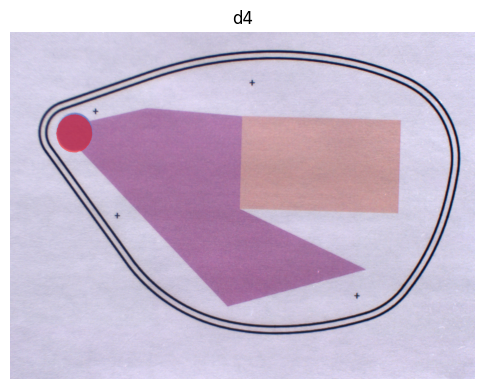

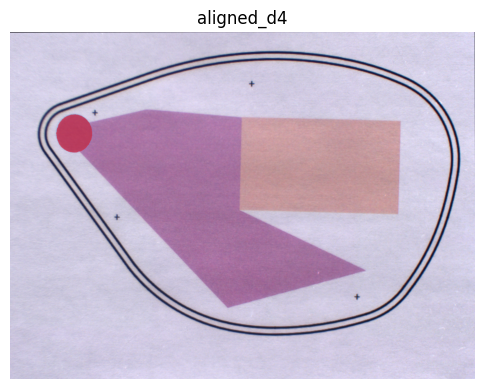

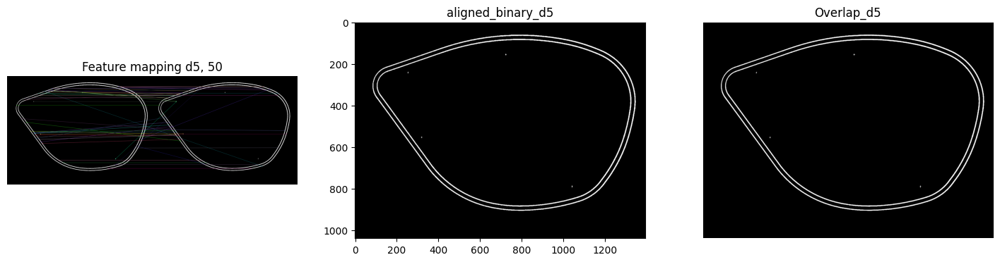


Affine (A as 3x3):
 [[ 9.99673354e-01 -8.96351151e-04  2.59137278e+01]
 [ 8.96351151e-04  9.99673354e-01 -2.71315200e-01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (25.91, -0.27)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: 0.05°


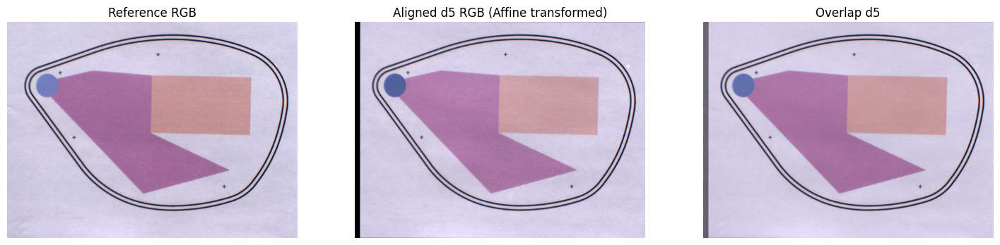

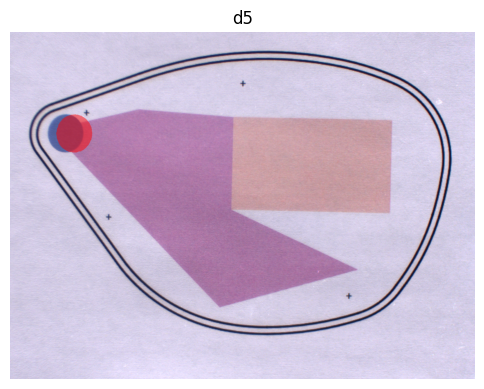

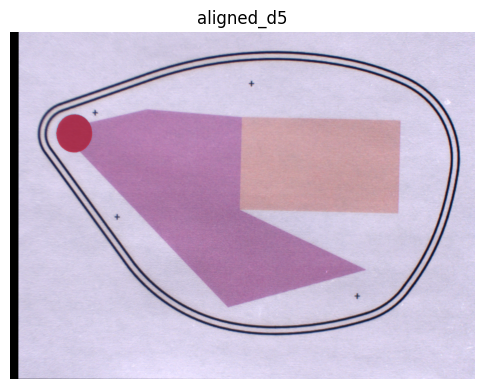

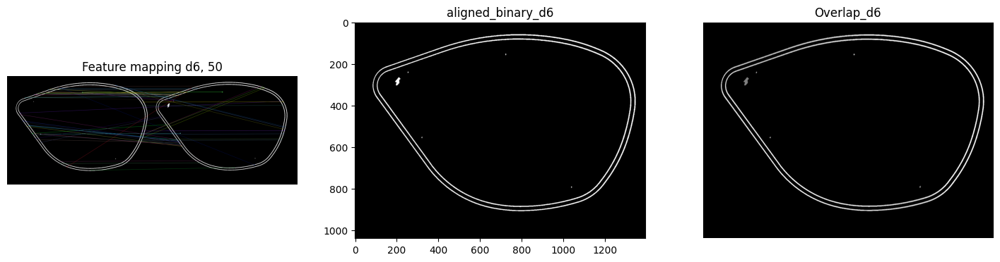


Affine (A as 3x3):
 [[ 1.00055429e+00  3.03712491e-03  5.08027179e+01]
 [-3.03712491e-03  1.00055429e+00  7.58416869e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (50.80, 7.58)
  Scale (sx, sy): (1.001, 1.001)
  Rotation: -0.17°


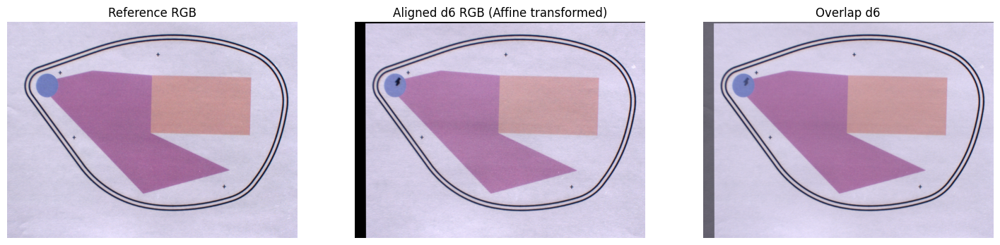

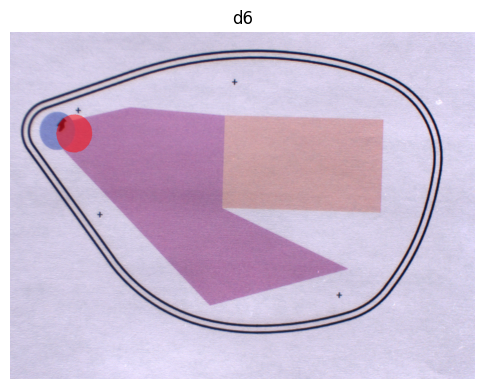

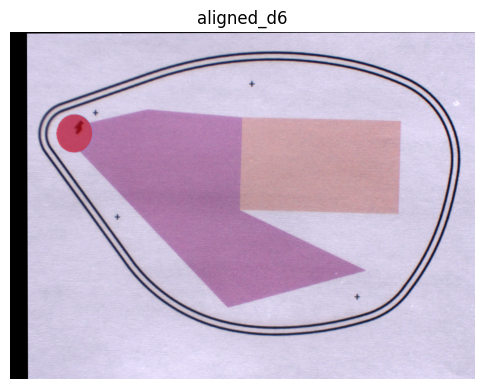

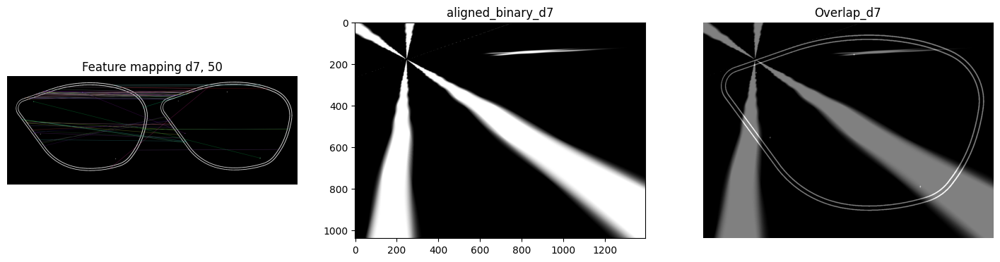


Affine (A as 3x3):
 [[ 9.99623324e-01 -4.77615882e-05  6.45387445e+00]
 [ 4.77615882e-05  9.99623324e-01  5.99689667e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (6.45, 6.00)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: 0.00°


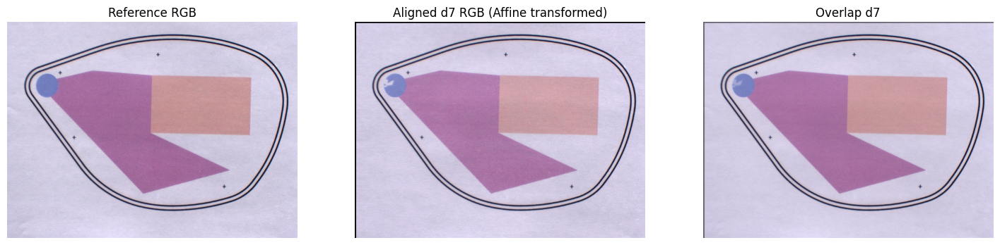

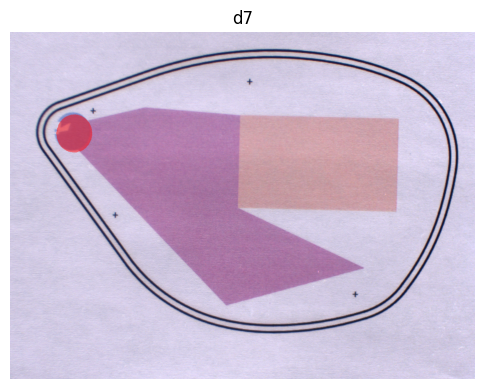

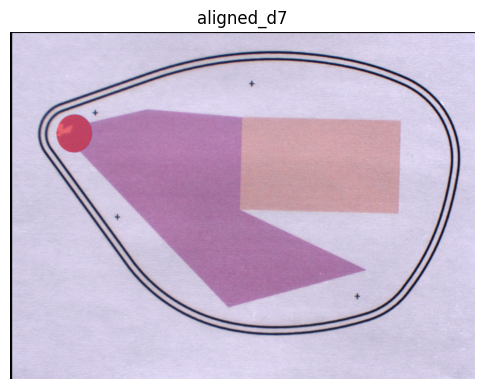

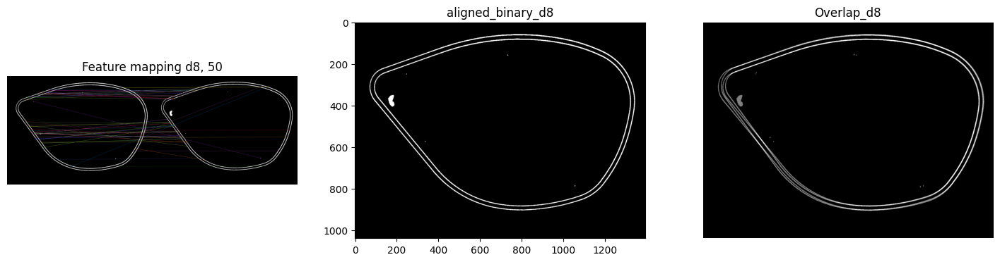


Affine (A as 3x3):
 [[ 9.99852460e-01  1.00398607e-03  2.16874711e-01]
 [-1.00398607e-03  9.99852460e-01  7.58854639e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (0.22, 7.59)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: -0.06°


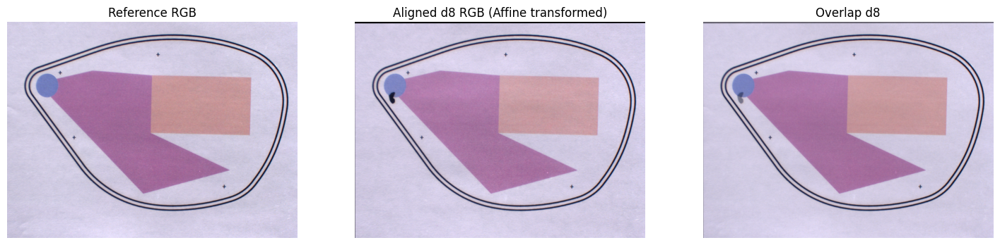

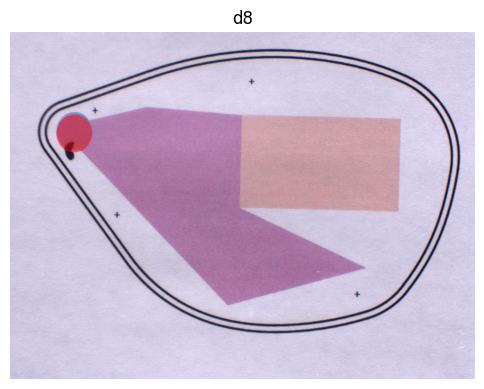

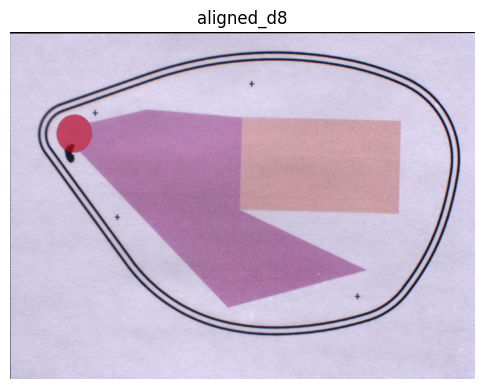

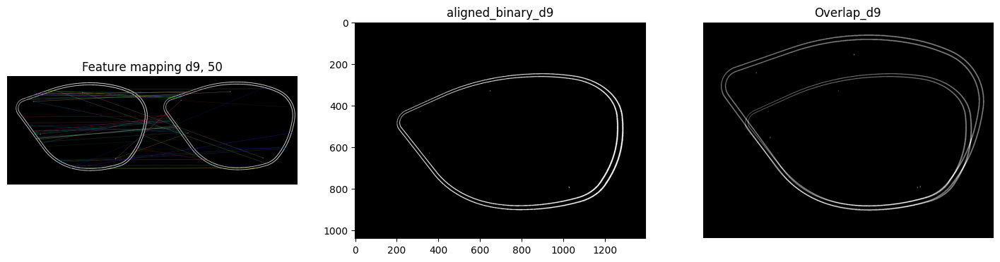


Affine (A as 3x3):
 [[ 1.00052268e+00  1.72240852e-03 -2.43667463e+01]
 [-1.72240852e-03  1.00052268e+00  8.54047332e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-24.37, 8.54)
  Scale (sx, sy): (1.001, 1.001)
  Rotation: -0.10°


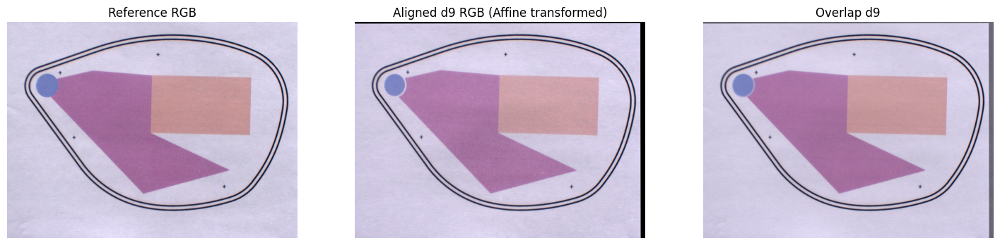

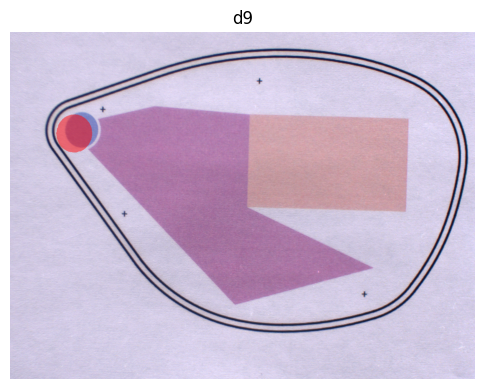

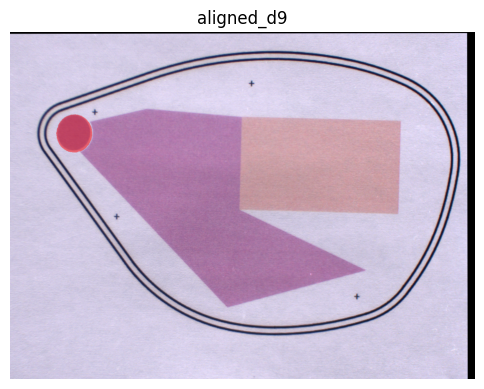

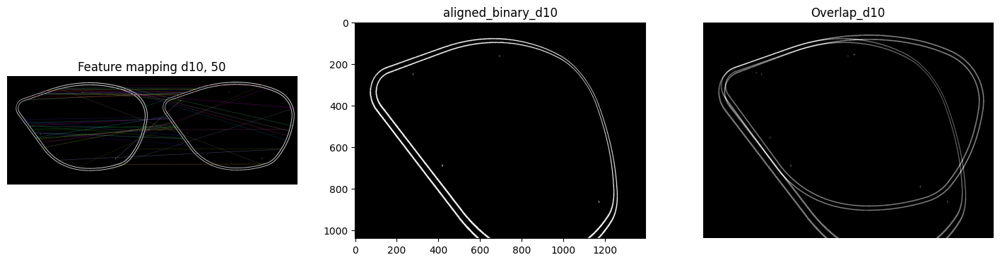


Affine (A as 3x3):
 [[ 1.00027778e+00  3.03639487e-03 -1.76388811e+01]
 [-3.03639487e-03  1.00027778e+00  7.53026909e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-17.64, 7.53)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: -0.17°


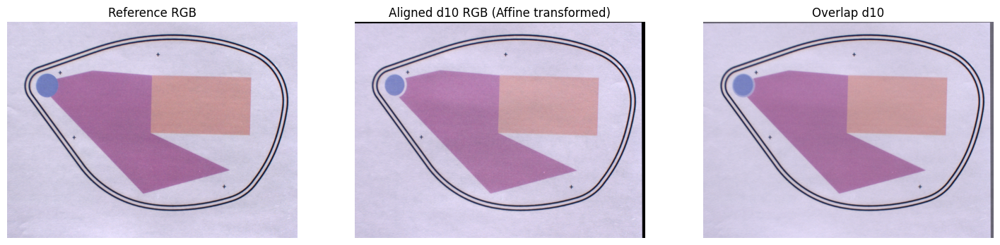

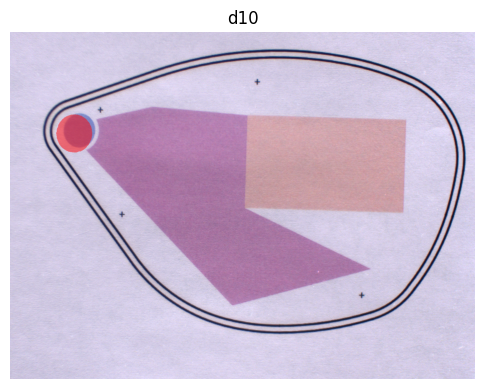

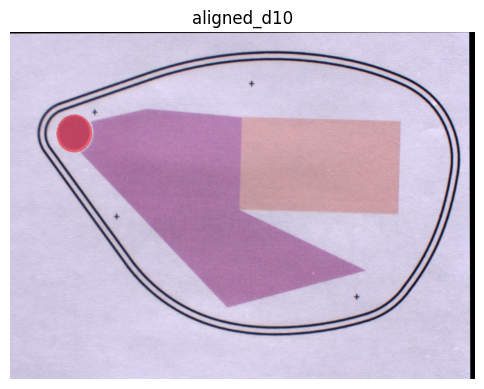

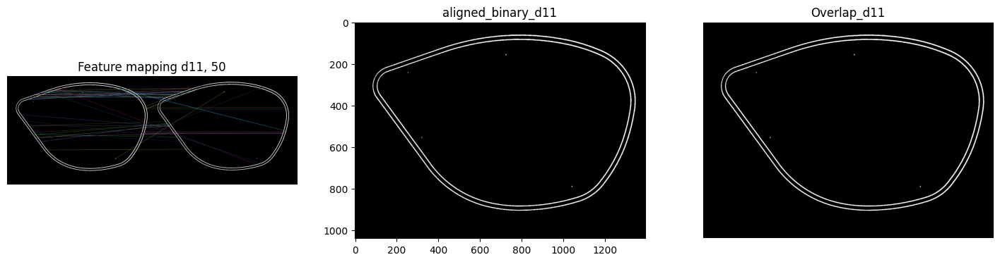


Affine (A as 3x3):
 [[ 1.00029340e+00  3.66080142e-03  3.46951416e+01]
 [-3.66080142e-03  1.00029340e+00  7.37736353e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (34.70, 7.38)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: -0.21°


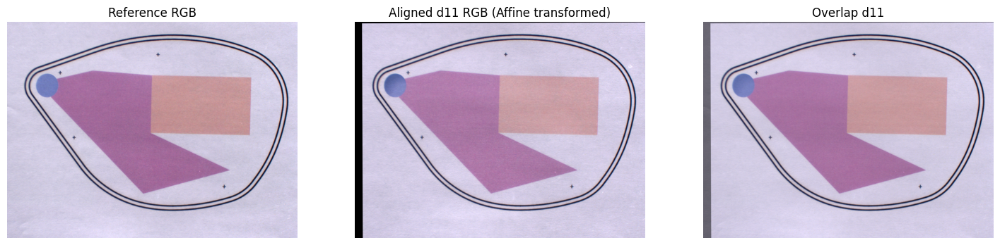

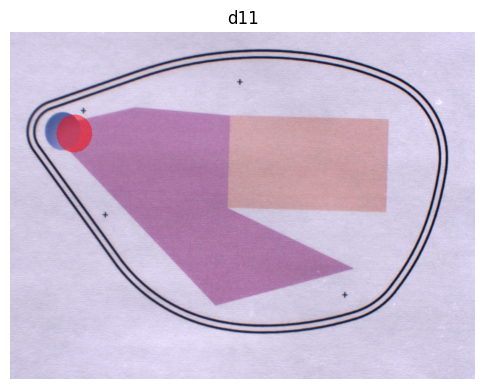

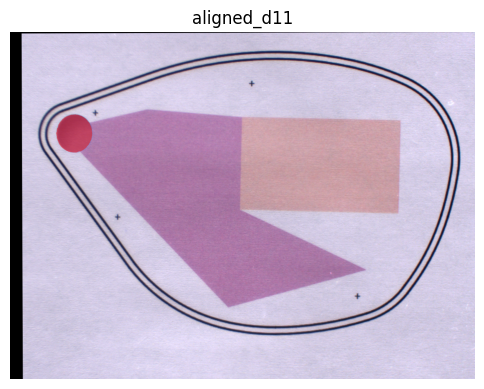

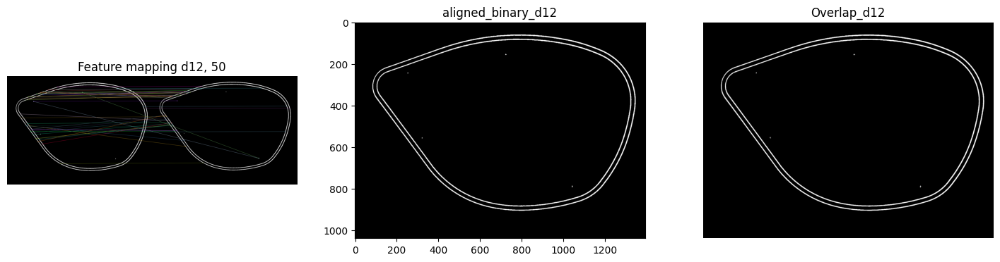


Affine (A as 3x3):
 [[ 1.00125215e+00  5.30952401e-03  1.42108351e+01]
 [-5.30952401e-03  1.00125215e+00  9.36152722e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (14.21, 9.36)
  Scale (sx, sy): (1.001, 1.001)
  Rotation: -0.30°


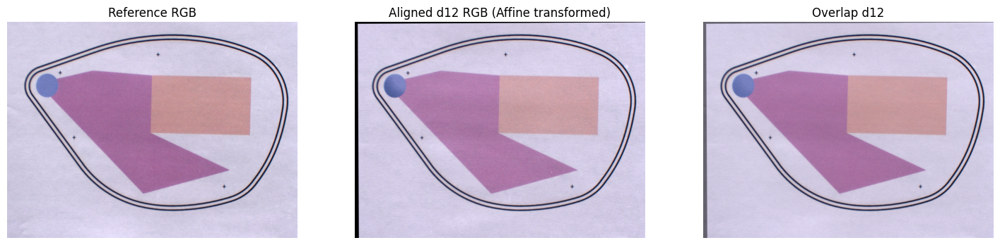

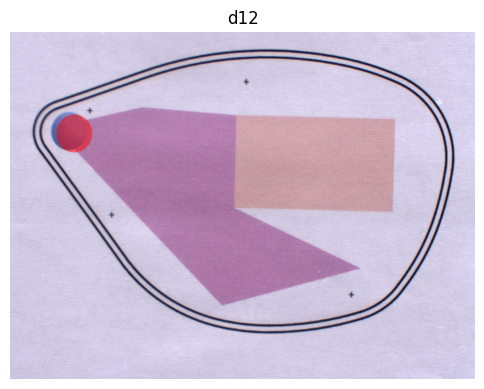

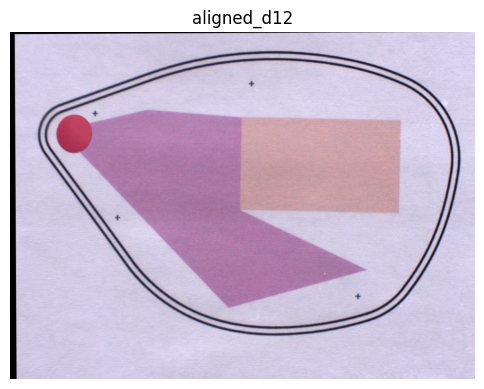

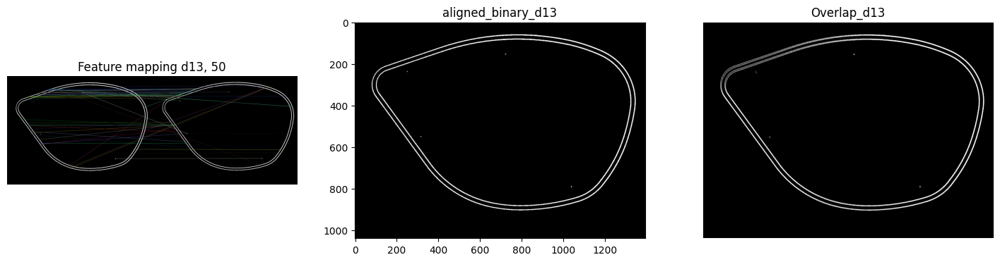


Affine (A as 3x3):
 [[ 1.00293630e+00 -6.38278295e-03 -1.29897685e+01]
 [ 6.38278295e-03  1.00293630e+00 -2.69899034e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-12.99, -2.70)
  Scale (sx, sy): (1.003, 1.003)
  Rotation: 0.36°


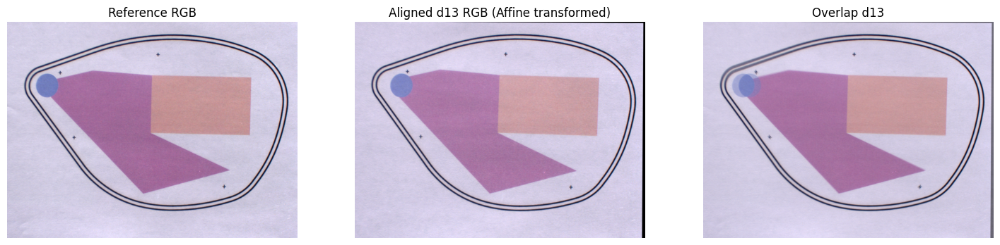

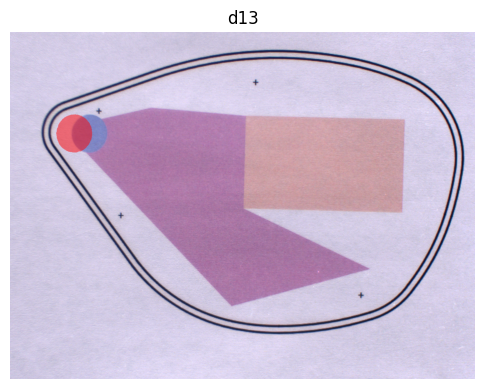

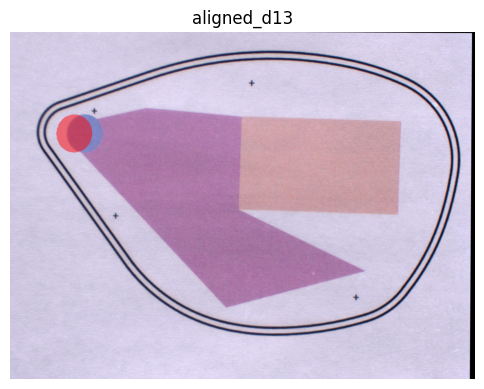

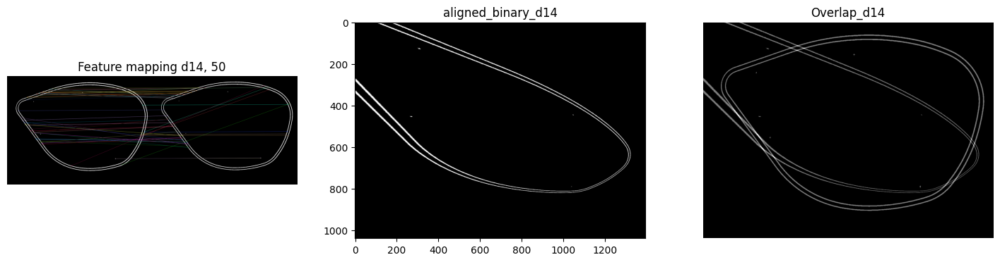


Affine (A as 3x3):
 [[ 9.99494223e-01  1.01581194e-03 -3.58883347e-01]
 [-1.01581194e-03  9.99494223e-01  7.99680298e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-0.36, 8.00)
  Scale (sx, sy): (0.999, 0.999)
  Rotation: -0.06°


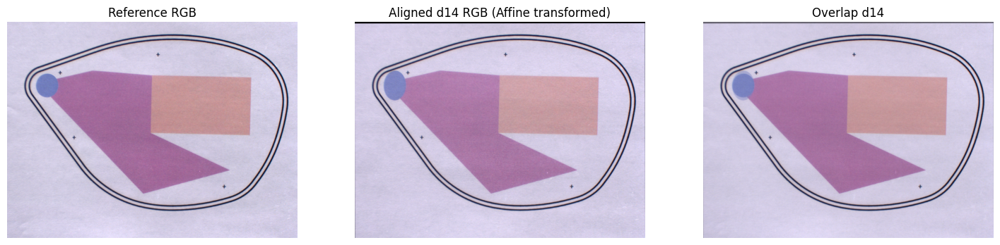

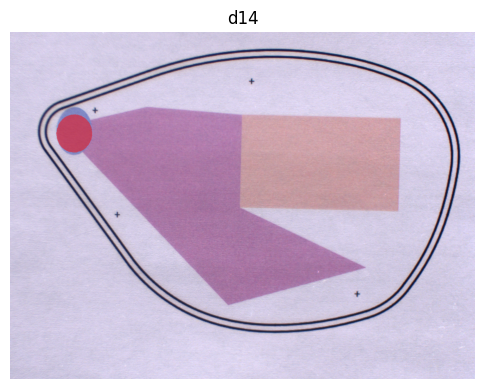

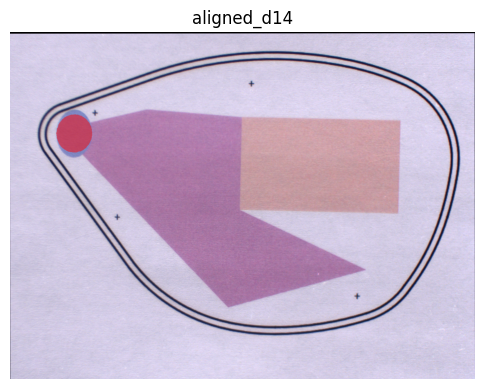

In [9]:
defect_affine = []

for i in range(len(defects)):
    binary_image = convert_binary_image(defect_cubes, defects[i], band)

    A_3x3 = align_and_visualise(R_image_binary, binary_image, defects[i])
    defect_affine.append(A_3x3)

    ref_RGB = extract_RGB(R_sample, wavelengths)
    defect_RGB = extract_RGB(defect_cubes[defects[i]], wavelengths)

    ref_rgb = np.moveaxis(ref_RGB, 0, -1)
    defect_rgb = np.moveaxis(defect_RGB, 0, -1)

    if ref_rgb.dtype != np.uint8:
        ref_rgb = np.clip(ref_rgb * 255, 0, 255).astype(np.uint8)
    if defect_rgb.dtype != np.uint8:
        defect_rgb = np.clip(defect_rgb * 255, 0, 255).astype(np.uint8)

    aligned_defect, blended = align_and_blend_RGB(
        ref_rgb, defect_rgb, A_3x3, defects[i]
    )

    overlay_mask(defect_rgb, ref_mask, defects[i], color=(1, 0, 0), alpha=0.5)
    overlay_mask(
        aligned_defect, ref_mask, f"aligned_{defects[i]}", color=(1, 0, 0), alpha=0.5
    )

In [13]:
def get_circle_info(mask):
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if not contours:
        return None

    largest_contour = max(contours, key=cv2.contourArea)

    M = cv2.moments(largest_contour)
    if M["m00"] == 0:
        return None

    centroid_x = M["m10"] / M["m00"]
    centroid_y = M["m01"] / M["m00"]

    area = cv2.contourArea(largest_contour)
    perimeter = cv2.arcLength(largest_contour, True)

    (x, y), radius = cv2.minEnclosingCircle(largest_contour)

    ellipse = cv2.fitEllipse(largest_contour) if len(largest_contour) >= 5 else None

    circularity = 4 * np.pi * area / (perimeter**2) if perimeter > 0 else 0

    return {
        "centroid": (centroid_x, centroid_y),
        "area": area,
        "perimeter": perimeter,
        "min_enclosing_circle": {"center": (x, y), "radius": radius},
        "ellipse": ellipse,
        "circularity": circularity,
        # "contour": largest_contour,
    }


circle_info = get_circle_info(ref_mask)
print(f"circle_info: {circle_info}")

print(f"len(defect_affine): {len(defect_affine)}")
print(f"defect_affine: {defect_affine}")
print(f"defect_affine[0]: {defect_affine[0]}")

circle_info: {'centroid': (191.98805403198608, 305.7539450094964), 'area': 9389.5, 'perimeter': 366.91882729530334, 'min_enclosing_circle': {'center': (191.6385040283203, 305.6613464355469), 'radius': 56.829063415527344}, 'ellipse': ((191.98439025878906, 305.7358093261719), (106.03638458251953, 112.76265716552734), 4.824965953826904), 'circularity': 0.8764201151536154}
len(defect_affine): 14
defect_affine: [array([[ 9.98127898e-01,  5.49397432e-03, -7.62823393e+00],
       [-5.49397432e-03,  9.98127898e-01,  3.79295797e+00],
       [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]]), array([[ 9.99740153e-01,  6.17398863e-03, -2.35394262e+01],
       [-6.17398863e-03,  9.99740153e-01,  9.43602856e+00],
       [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]]), array([[ 1.02904138e+00,  1.83454330e-02, -3.81042368e+01],
       [-1.83454330e-02,  1.02904138e+00,  1.35342157e+01],
       [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]]), array([[ 1.00120035e+00,  2.14718166e-03, -